# Preprocessing the Data

In [1]:
import pandas as pd
import DyLoPro as dlp

In [2]:
from preprocess_case_studies import preprocess_bpic12
path_to_bpic12 = 'BPIC_12.csv'
log = pd.read_csv(path_to_bpic12, header = 0)
log = preprocess_bpic12(log)

In [3]:
log.head()

,org:resource,lifecycle:transition,concept:name,time:timestamp,case:REG_DATE,case:concept:name,case:AMOUNT_REQ,case_duration,time_since_case_start,inter_event_time,case_declined,case_cancelled,case:outcome
0,112.0,COMPLETE,A_SUBMITTED,2011-10-01 00:38:44.546000+00:00,2011-10-01 00:38:44.546000+00:00,173688,20000,1072732.48,0.000,NaN,0,0,W_Valideren aanvraag
1,112.0,COMPLETE,A_PARTLYSUBMITTED,2011-10-01 00:38:44.880000+00:00,2011-10-01 00:38:44.546000+00:00,173688,20000,1072732.48,0.334,0.334,0,0,W_Valideren aanvraag
2,112.0,COMPLETE,A_PREACCEPTED,2011-10-01 00:39:37.906000+00:00,2011-10-01 00:38:44.546000+00:00,173688,20000,1072732.48,53.360,53.026,0,0,W_Valideren aanvraag
3,112.0,SCHEDULE,W_Completeren aanvraag,2011-10-01 00:39:38.875000+00:00,2011-10-01 00:38:44.546000+00:00,173688,20000,1072732.48,54.329,0.969,0,0,W_Valideren aanvraag
4,NaN,START,W_Completeren aanvraag,2011-10-01 11:36:46.437000+00:00,2011-10-01 00:38:44.546000+00:00,173688,20000,1072732.48,39481.891,39427.562,0,0,W_Valideren aanvraag


In [4]:
# BPIC 2012 features

# Categorical features at the case (trace) level
categorical_casefeatures = [
    'case:APPLICATION_TYPE',
    'case:GOAL',
    'case:CHANNEL',
    'case:RESOURCE',
    'case:outcome',
]

# Numeric features at the case (trace) level
numeric_casefeatures = [
    'case:AMOUNT_REQ',
    'case:DURATION',
    'case_approved',
    'case_declined',
    'case_cancelled',
]

# Categorical features at the event level
categorical_eventfeatures = [
    'concept:name',
    'lifecycle:transition',
    'org:resource',
    'org:role',
]

# Numeric features at the event level
numeric_eventfeatures = [
    'event_nr',
    'time_since_case_start',
    'inter_event_time',
]


In [5]:
# --- Filter only features that exist in the log ---
categorical_casefeatures = [f for f in categorical_casefeatures if f in log.columns]
numeric_casefeatures = [f for f in numeric_casefeatures if f in log.columns]
categorical_eventfeatures = [f for f in categorical_eventfeatures if f in log.columns]
numeric_eventfeatures = [f for f in numeric_eventfeatures if f in log.columns]

# --- Create Dynamic Log Plots instance ---
bpic12_plots = dlp.DynamicLogPlots(
    log,
    case_id_key='case:concept:name',
    activity_key='concept:name',
    timestamp_key='time:timestamp',
    categorical_casefeatures=categorical_casefeatures,
    numerical_casefeatures=numeric_casefeatures,
    categorical_eventfeatures=categorical_eventfeatures,
    numerical_eventfeatures=numeric_eventfeatures
)

Preprocessing the data...


C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\preprocess_utils.py:274: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  log['hourly_timestamp'] = timestamps.dt.floor("1H")
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\preprocess_utils.py:277: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  log['2hour_timestamp'] = timestamps.dt.floor("2H")
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\preprocess_utils.py:280: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  log['12hour_timestamp'] = timestamps.dt.floor("12H")
100%|██████████| 261914/261914 [00:00<00:00, 1814289.65it/s]


# Variants

In [6]:
var_df = bpic12_plots.get_var_df(max_k=10, counts=True)
print(var_df.to_string())

                                                                                                                                                                                                                                                                                                        variant  variant count
variant number                                                                                                                                                                                                                                                                                                                
1                                                                                                                                                                                                                                                                  (A_SUBMITTED, A_PARTLYSUBMITTED, A_DECLINED)           3420
2                                          

Computing additional weekly Throughput Time aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 100.10it/s]


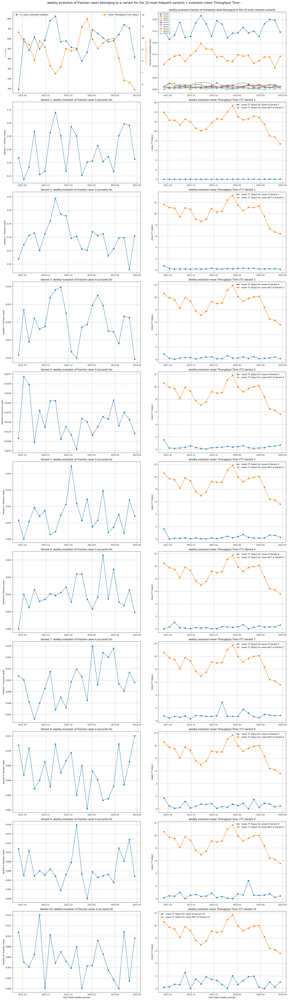

In [7]:
bpic12_plots.topK_variants_evol(plt_type = 'type_tt')

### 1.2 Representation type: **Outcome**

### 1.2.A: Outcome - '**case declined**'

Computing additional weekly outcome aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 27.20it/s]


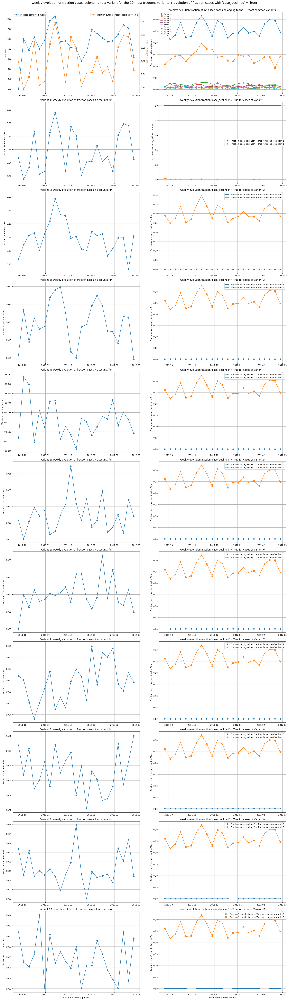

In [8]:
bpic12_plots.set_outcomeColumn(outcome = 'case_declined')
bpic12_plots.topK_variants_evol(plt_type = 'type_outcome')

### 1.2.B: Outcome - '**case cancelled**'

Computing additional weekly outcome aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 32.93it/s]


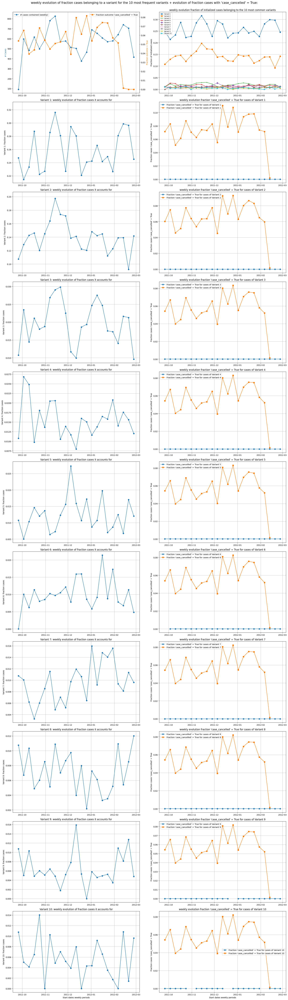

In [9]:
bpic12_plots.set_outcomeColumn(outcome = 'case_cancelled')
bpic12_plots.topK_variants_evol(plt_type = 'type_outcome')

# Categorical Case Features

In [10]:
# display categorical case features known in the notebook and (if present) on the bpic12_plots object
print("categorical_casefeatures:", categorical_casefeatures)

# also try to read from the bpic12_plots object if it exposes the attribute
if hasattr(bpic12_plots, "categorical_casefeatures"):
    print("bpic12_plots.categorical_casefeatures:", bpic12_plots.categorical_casefeatures)

categorical_casefeatures: ['case:outcome']
bpic12_plots.categorical_casefeatures: ['case:outcome']


# Categorical Case Features

### Case 2.1 'case:outcome' - Representation type: Throughput Time (TT)

Computing additional weekly aggregations of the Throughput Time for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 60.03it/s]


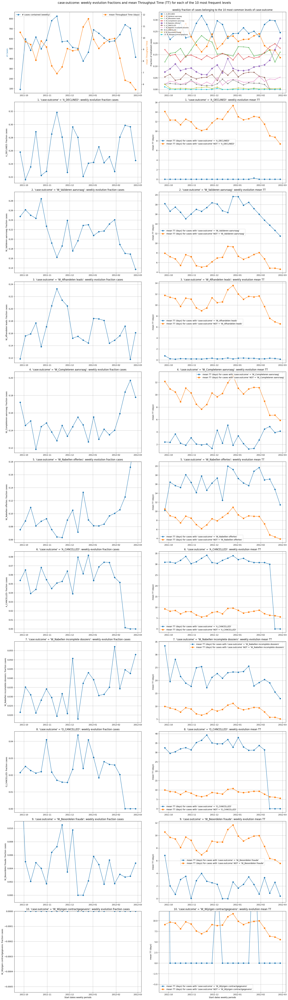

In [11]:
bpic12_plots.topK_categorical_caseftr_evol(case_feature = 'case:outcome', plt_type = 'type_tt')

### Case 2.2 'case:outcome' - Representation type: Case Length (NEPC)


Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 70.28it/s]


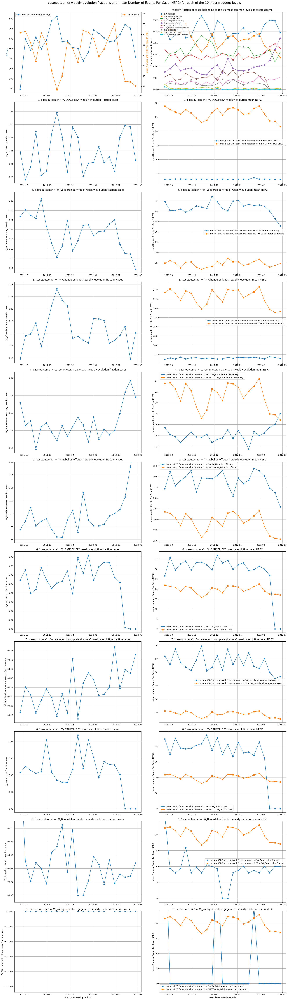

In [12]:
bpic12_plots.topK_categorical_caseftr_evol(case_feature = 'case:outcome', plt_type = 'type_events_case')

# Numeric Case Features

In [13]:
# display numeric case features known in the notebook and (if present) on the bpic12_plots object
print("numeric_casefeatures:", numeric_casefeatures)

# also try to read from the bpic12_plots object if it exposes the attribute
if hasattr(bpic12_plots, "numeric_casefeatures"):
    print("bpic12_plots.numeric_casefeatures:", bpic12_plots.numeric_casefeatures)

numeric_casefeatures: ['case:AMOUNT_REQ', 'case_declined', 'case_cancelled']


We will filter out case_declined and case_cancelled since they do not make sense for the plots. 

In [14]:
# create a copy of numeric_casefeatures and remove the two flags
numeric_casefeatures_copy = [f for f in numeric_casefeatures if f not in {'case_declined', 'case_cancelled'}]

# show the result
numeric_casefeatures_copy

['case:AMOUNT_REQ']

### Case 3.1 'case:AMOUNT_REQ'- Representation type: Throughput Time (TT)

C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:452: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  period_ttr = case_log_loc.pivot_table(values = num_fts_list, index = time_col, aggfunc = numeric_agg, fill_value = 0)


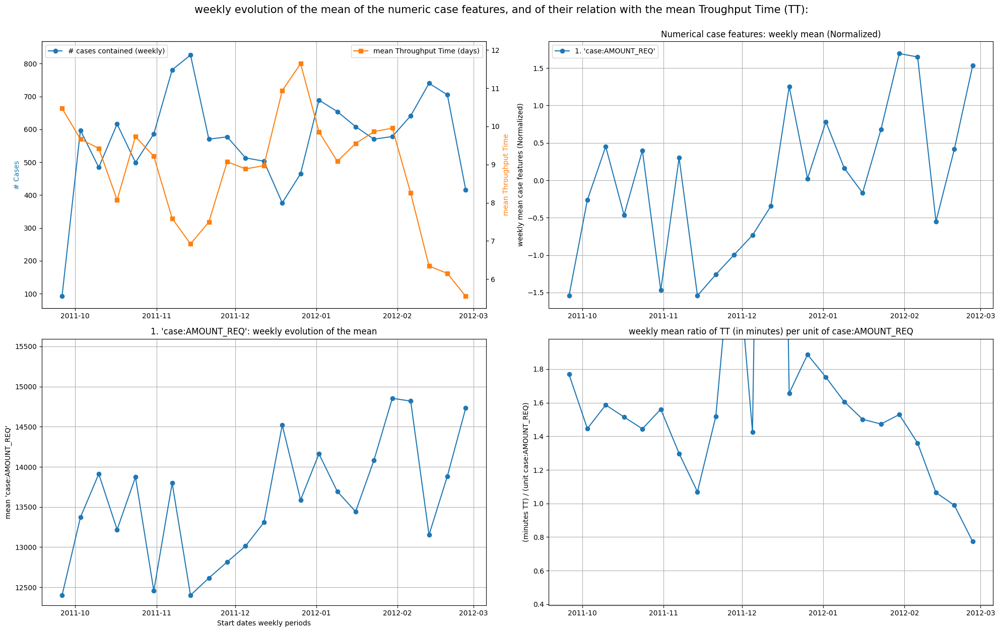

In [15]:
bpic12_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures_copy, plt_type = 'type_tt')

### Case 3.2 'case:AMOUNT_REQ'- Representation type: Case Length (NEPC)

Computing the additional weekly NEPC aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 31.66it/s]


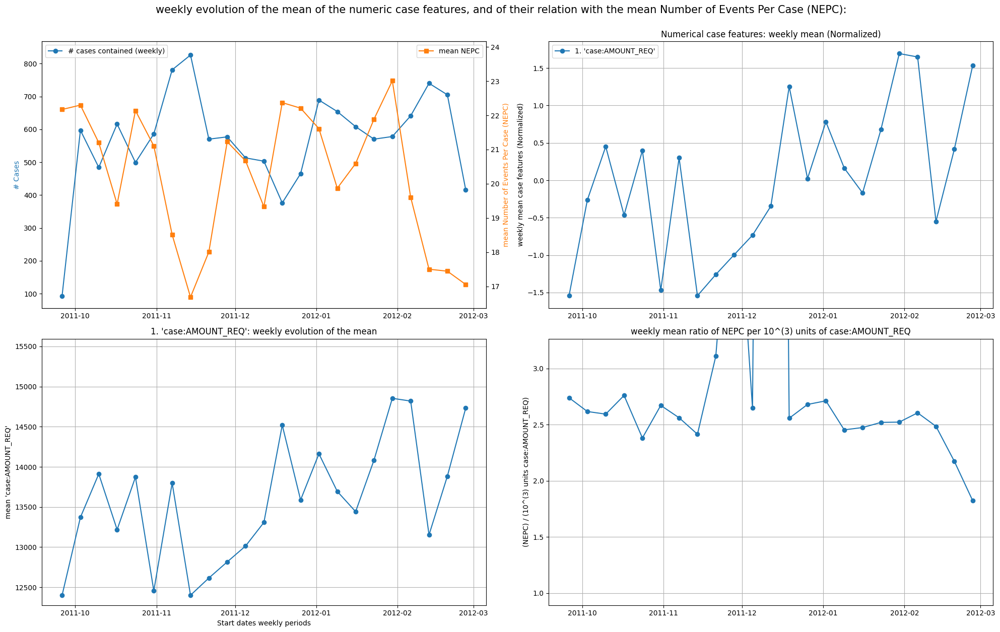

In [16]:
bpic12_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures_copy, plt_type = 'type_events_case')

### Case 3.3: 'case:AMOUNT_REQ' - Representation type: Outcome

#### Case 3.3.1: Outcome - 'case declined'

Computing the additional weekly outcome aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 34.41it/s]


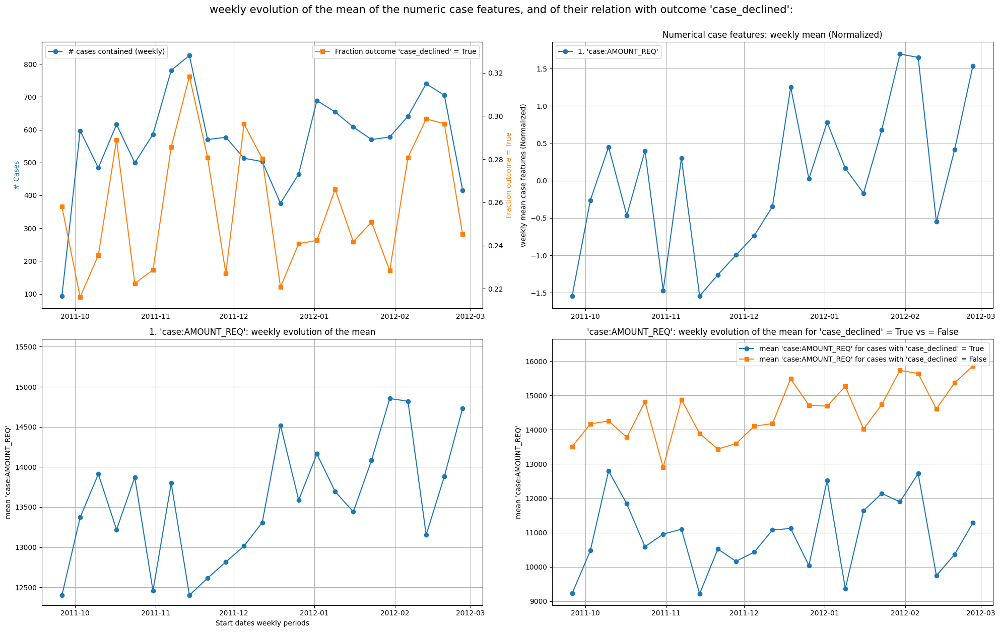

In [17]:
bpic12_plots.set_outcomeColumn(outcome = 'case_declined')
bpic12_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures_copy, plt_type = 'type_outcome')

#### Case 3.3.1: Outcome - 'case cancelled'

Computing the additional weekly outcome aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 32.38it/s]


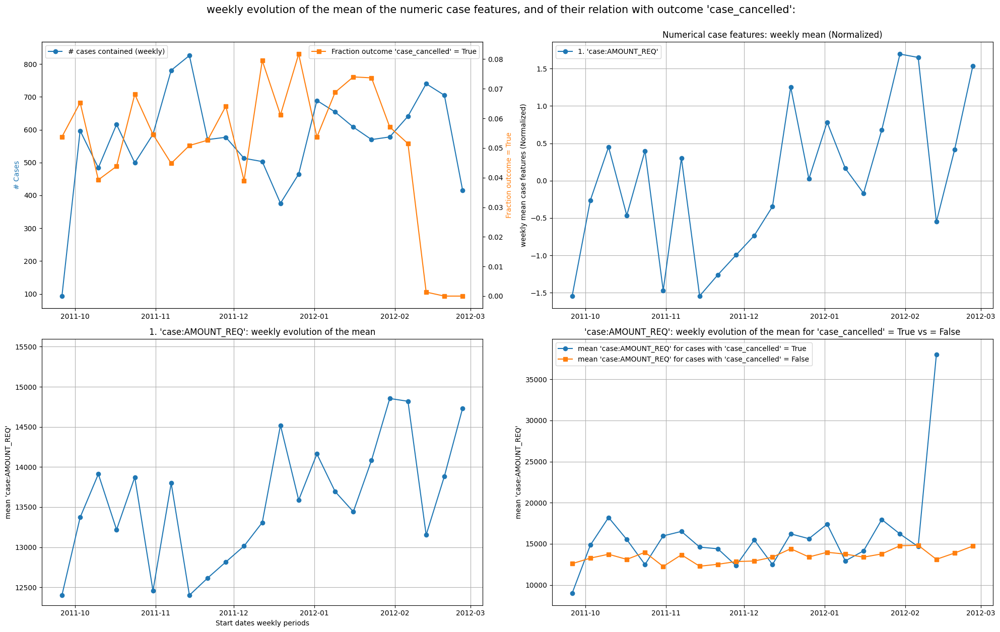

In [18]:
bpic12_plots.set_outcomeColumn(outcome = 'case_cancelled')
bpic12_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures_copy, plt_type = 'type_outcome')

# Categorical Event Features

In [19]:
categorical_eventfeatures

['concept:name', 'lifecycle:transition', 'org:resource']

## 4.1 Categorical event feature: 'concept:resource'

### 4.1.1 'org:resource' - Representation type: Throughput Time (TT)

In [20]:
bpic12_plots.log['weekly_timestamp_firstev'] = (
    bpic12_plots.log['time:timestamp']
    .dt.to_period('W')
    .apply(lambda r: r.start_time)
)

In [21]:
bpic12_plots.log = bpic12_plots.log.sort_values(['case:concept:name', 'time:timestamp'])

# compute days since the first event in each case
bpic12_plots.log['tt_days'] = (
    bpic12_plots.log.groupby('case:concept:name')['time:timestamp']
    .transform(lambda x: (x - x.min()).dt.days)
)

In [23]:
bpic12_plots.log['org:resource'] = (
    bpic12_plots.log['org:resource']
    .astype(str)
    .replace('nan', 'Unknown')
)

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 42.81it/s]
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:387: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


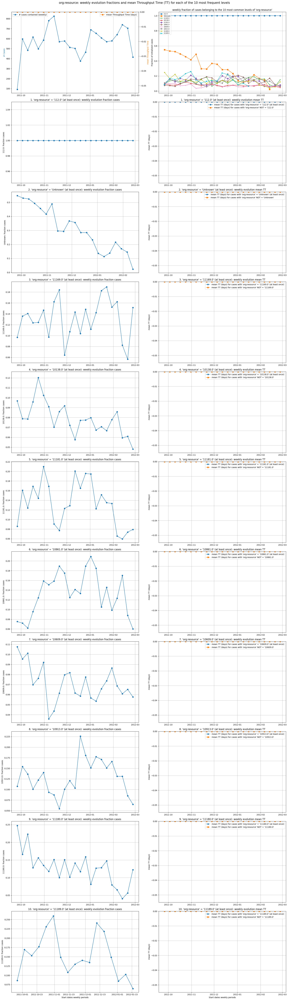

In [24]:
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'org:resource', plt_type = 'type_tt')

### 4.1.2 'org:resource' - Representation type: Case Length (NEPC)

In [25]:
bpic12_plots.log['num_events'] = (
    bpic12_plots.log.groupby('case:concept:name').transform('size')
)

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 38.52it/s]
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:387: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


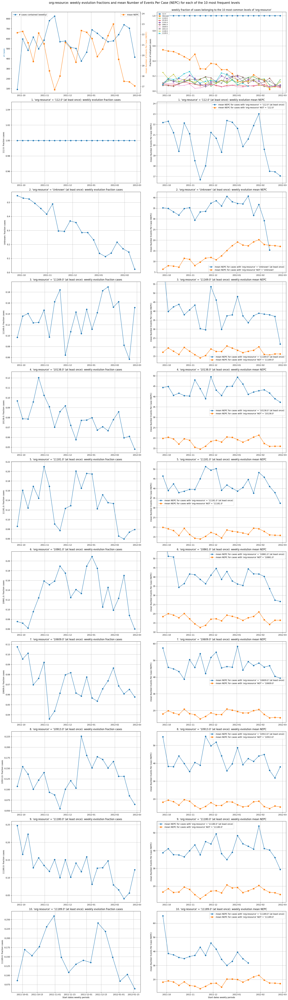

In [26]:
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'org:resource', plt_type = 'type_events_case')

### 4.1.3 'org:resource' - Representation type: Outcome

#### 4.1.3.A Outcome - 'case declined'

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 25.92it/s]
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:387: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


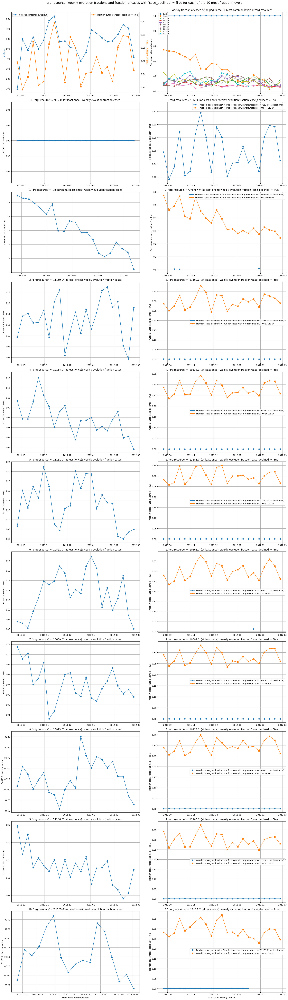

In [27]:
bpic12_plots.set_outcomeColumn(outcome = 'case_declined')
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'org:resource', plt_type = 'type_outcome')

#### 4.1.3.B Outcome - 'case cancelled'

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 24.16it/s]
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:387: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


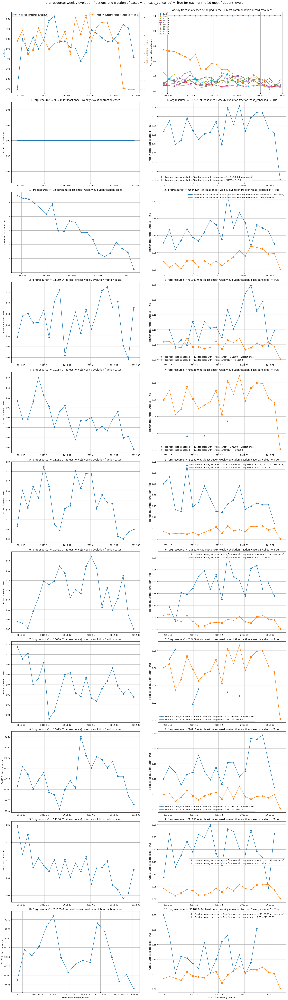

In [28]:
bpic12_plots.set_outcomeColumn(outcome = 'case_cancelled')
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'org:resource', plt_type = 'type_outcome')

## 4.2 Categorical event feature: 'concept:name'

### 4.2.1 'concept:name' - Representation type: Throughput Time (TT)

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 41.35it/s]


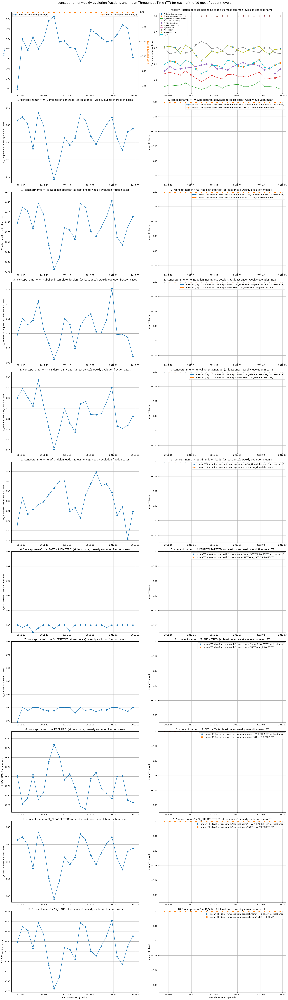

In [29]:
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'concept:name', plt_type = 'type_tt')

### 4.2.2 'concept:name' - Representation type: Case Length (NEPC)

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 36.97it/s]


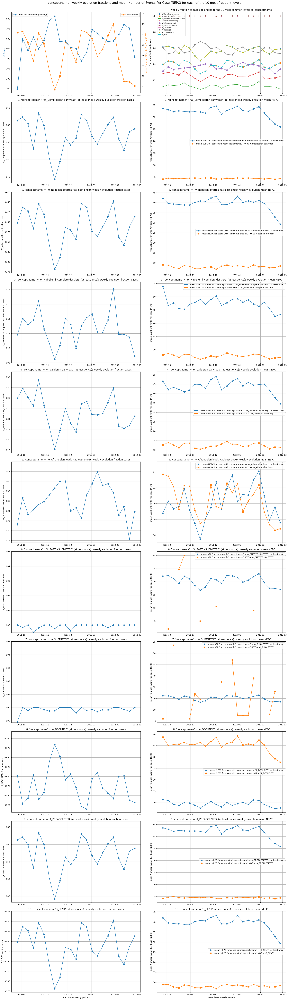

In [30]:
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'concept:name', plt_type = 'type_events_case')

### 4.2.3 'concept:name' - Representation type: Outcome

#### 4.2.3.A Outcome - 'case declined'

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 23.32it/s]


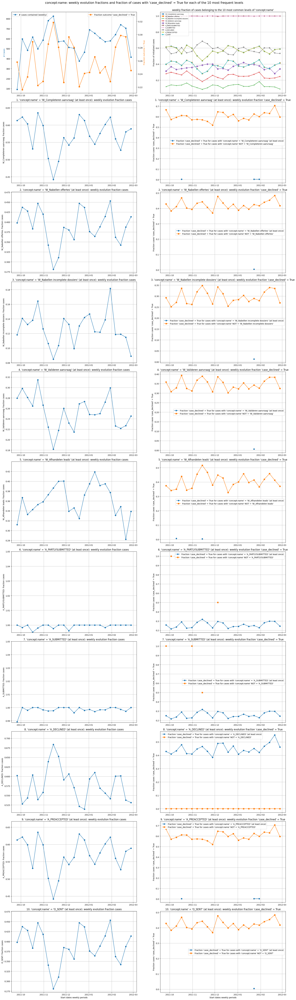

In [31]:
bpic12_plots.set_outcomeColumn(outcome = 'case_declined')
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'concept:name', plt_type = 'type_outcome')

#### 4.2.3.B Outcome - 'case cancelled'

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 23.10it/s]


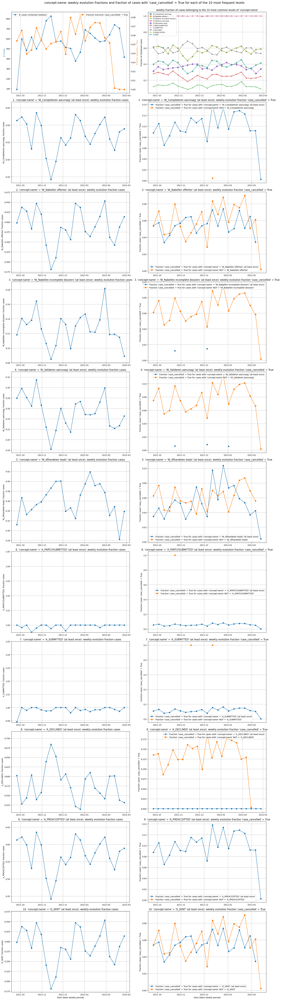

In [32]:
bpic12_plots.set_outcomeColumn(outcome = 'case_cancelled')
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'concept:name', plt_type = 'type_outcome')

## 4.3 Categorical event feature: 'lifecycle:transition'

### 4.3.1 'lifecycle:transition' - Representation type: Throughput Time (TT)

Computing the weekly aggregations for each of the 3 most frequently occurring levels of categorical event feature 'lifecycle:transition': 100%|██████████| 3/3 [00:00<00:00, 37.00it/s]
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:387: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


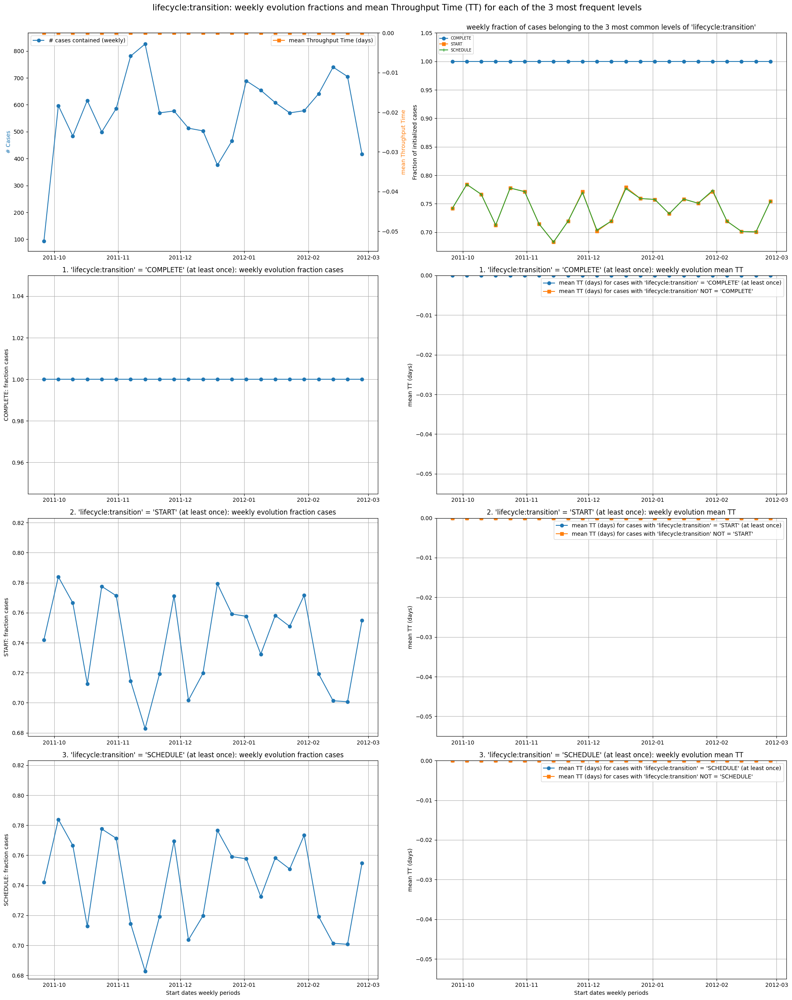

In [33]:
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'lifecycle:transition', plt_type = 'type_tt')

### 4.3.2 'lifecycle:transition' - Representation type: Case Length (NEPC)

Computing the weekly aggregations for each of the 3 most frequently occurring levels of categorical event feature 'lifecycle:transition': 100%|██████████| 3/3 [00:00<00:00, 44.38it/s]
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:387: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


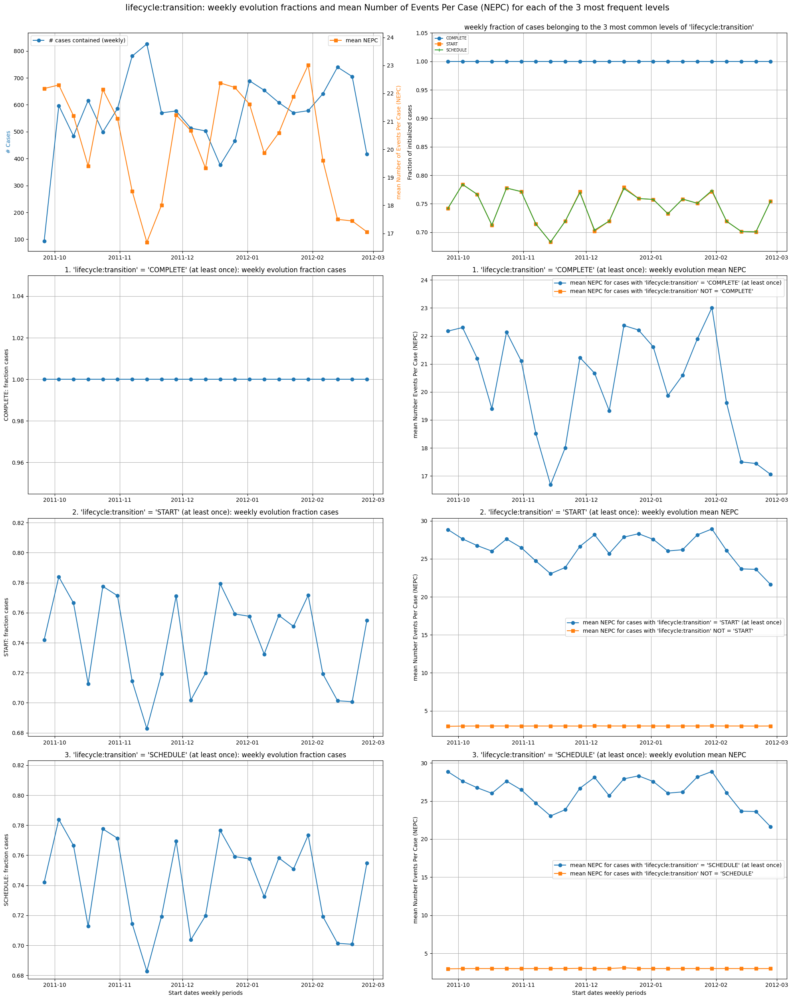

In [34]:
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'lifecycle:transition', plt_type = 'type_events_case')

### 4.3.3 'concept:name' - Representation type: Outcome

#### 4.3.3.A Outcome - 'case declined'

Computing the weekly aggregations for each of the 3 most frequently occurring levels of categorical event feature 'lifecycle:transition': 100%|██████████| 3/3 [00:00<00:00, 25.15it/s]
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:387: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


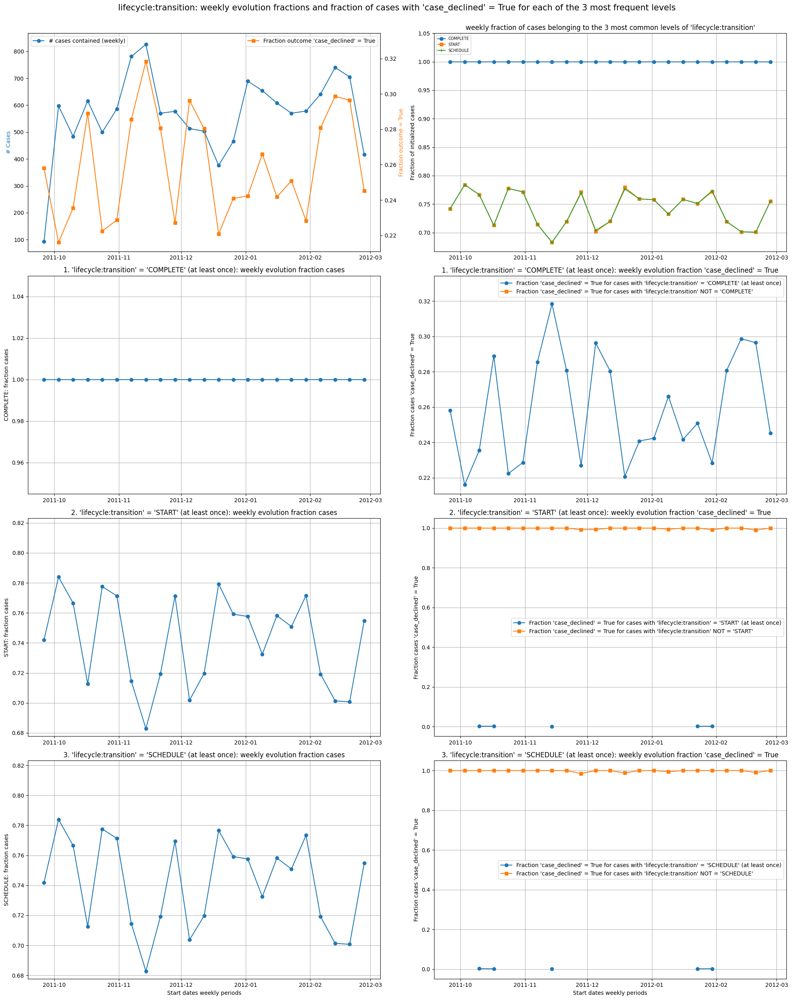

In [35]:
bpic12_plots.set_outcomeColumn(outcome = 'case_declined')
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'lifecycle:transition', plt_type = 'type_outcome')

#### 4.3.3.B Outcome - 'case cancelled'

Computing the weekly aggregations for each of the 3 most frequently occurring levels of categorical event feature 'lifecycle:transition': 100%|██████████| 3/3 [00:00<00:00, 29.82it/s]
C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:387: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


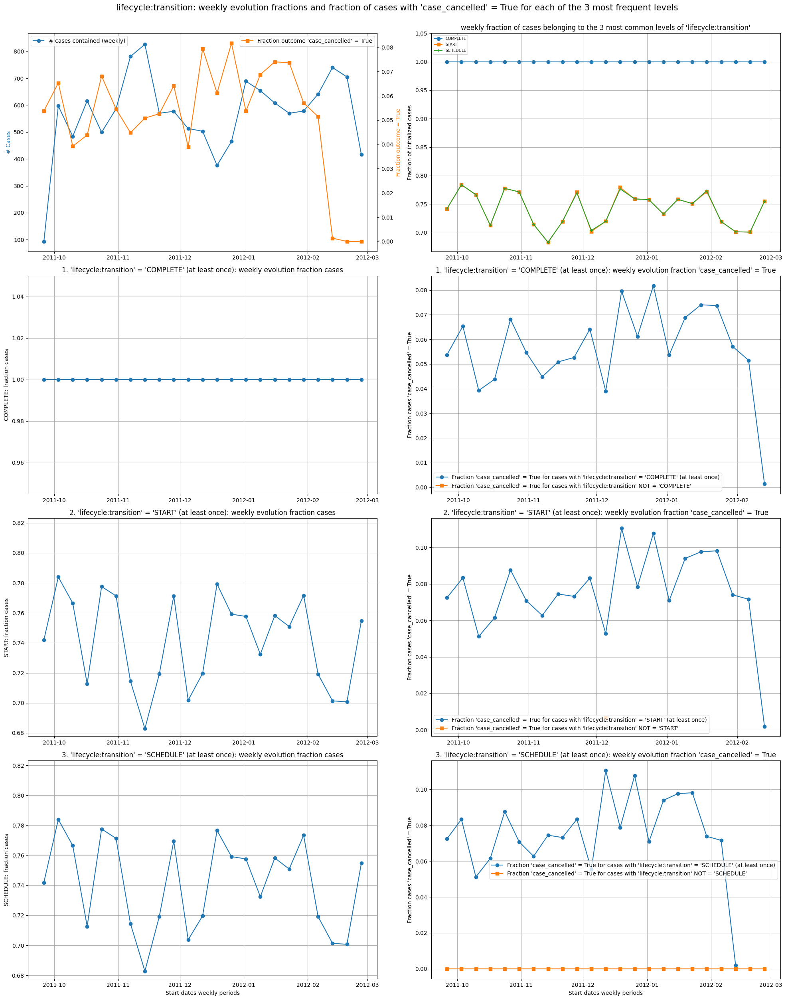

In [36]:
bpic12_plots.set_outcomeColumn(outcome = 'case_cancelled')
bpic12_plots.topK_categorical_eventftr_evol(event_feature = 'lifecycle:transition', plt_type = 'type_outcome')

# Numerical Event Features

In [38]:
# display numerical event features known in the notebook and (if present) on the bpic12_plots object
print("numeric_eventfeatures:", numeric_eventfeatures)
    
# also try to read from the bpic12_plots object if it exposes the attribute
if hasattr(bpic12_plots, "numeric_eventfeatures"):
    print("bpic12_plots.numeric_eventfeatures:", bpic12_plots.numeric_eventfeatures)

numeric_eventfeatures: ['time_since_case_start', 'inter_event_time']


### 5.1 Representation type: Throughput Time (TT)

C:\Users\20212379\AppData\Roaming\Python\Python310\site-packages\DyLoPro\plotting_utils.py:452: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  period_ttr = case_log_loc.pivot_table(values = num_fts_list, index = time_col, aggfunc = numeric_agg, fill_value = 0)


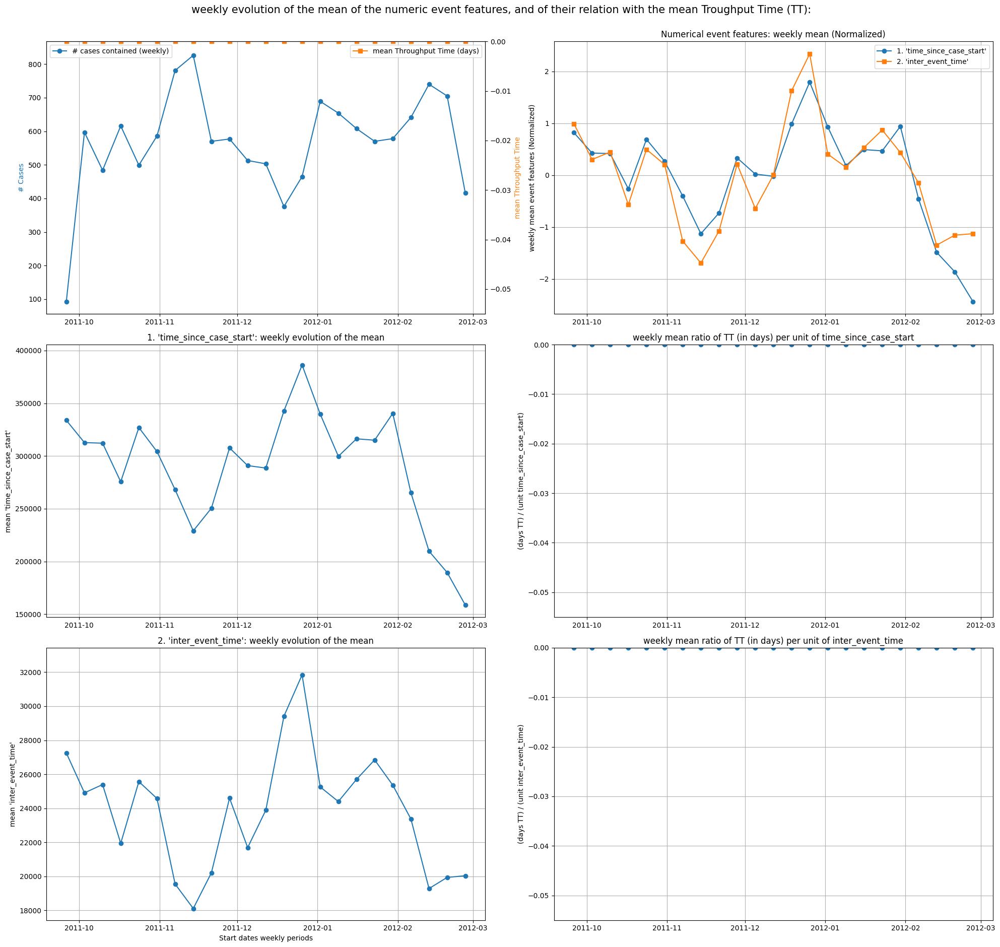

In [39]:
bpic12_plots.num_eventfts_evol(numeric_event_list = numeric_eventfeatures, plt_type = 'type_tt', numEventFt_transform = 'mean')

### 5.2 Representation type: Case Length (NEPC)

Computing the additional weekly NEPC aggregations for each of the 2 given numerical event features: 100%|██████████| 2/2 [00:00<00:00, 41.77it/s]


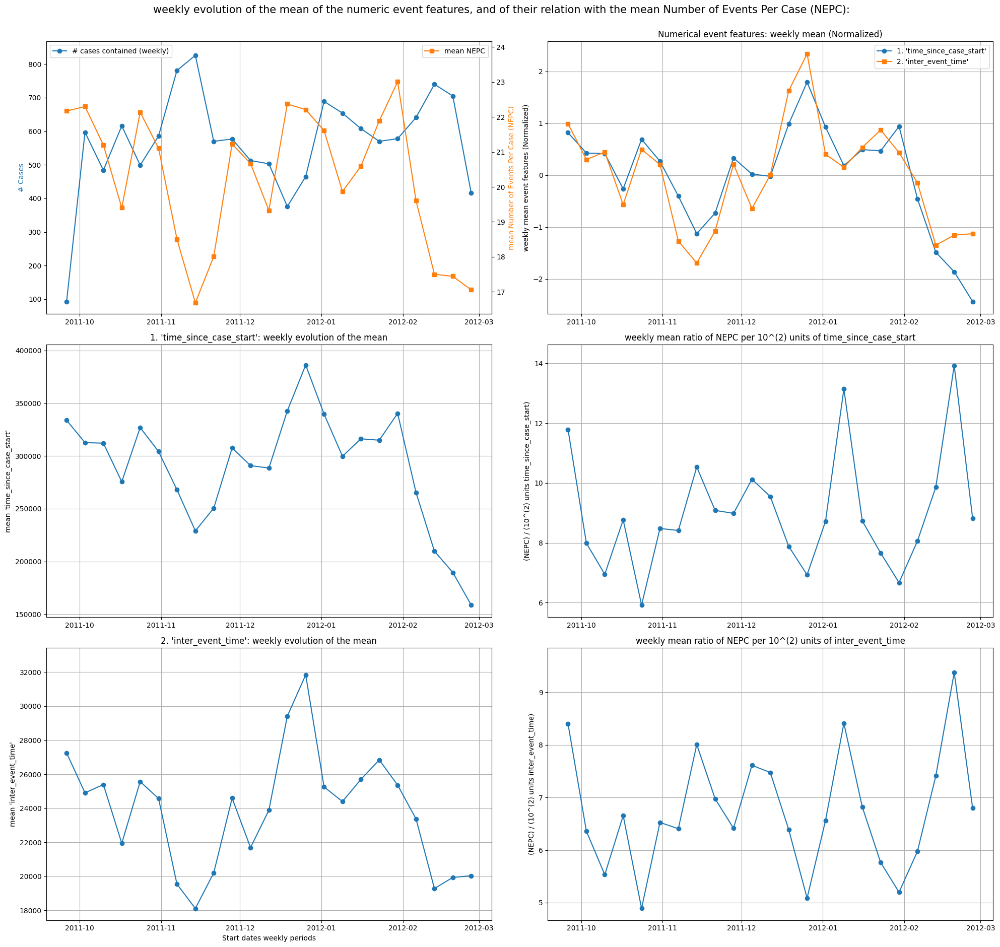

In [40]:
bpic12_plots.num_eventfts_evol(numeric_event_list = numeric_eventfeatures, plt_type = 'type_events_case', numEventFt_transform = 'mean')

### 5.2 Representation type: Outcome

#### 5.2.A Outcome - 'case declined'

Computing the additional weekly outcome aggregations for each of the 2 given numerical event features: 100%|██████████| 2/2 [00:00<00:00, 34.76it/s]


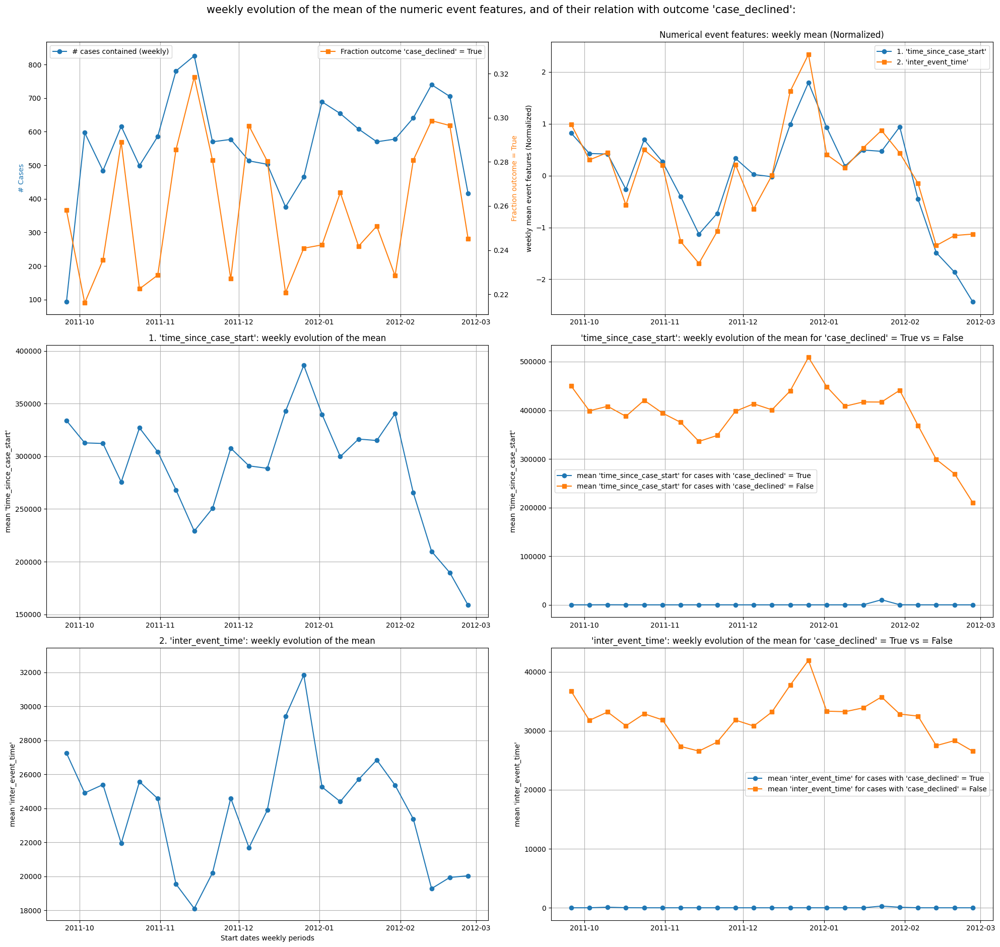

In [41]:
bpic12_plots.set_outcomeColumn(outcome = 'case_declined')
bpic12_plots.num_eventfts_evol(numeric_event_list = numeric_eventfeatures, plt_type = 'type_outcome', numEventFt_transform = 'mean')

#### 5.2.B Outcome - 'case cancelled'

Computing the additional weekly outcome aggregations for each of the 2 given numerical event features: 100%|██████████| 2/2 [00:00<00:00, 32.74it/s]


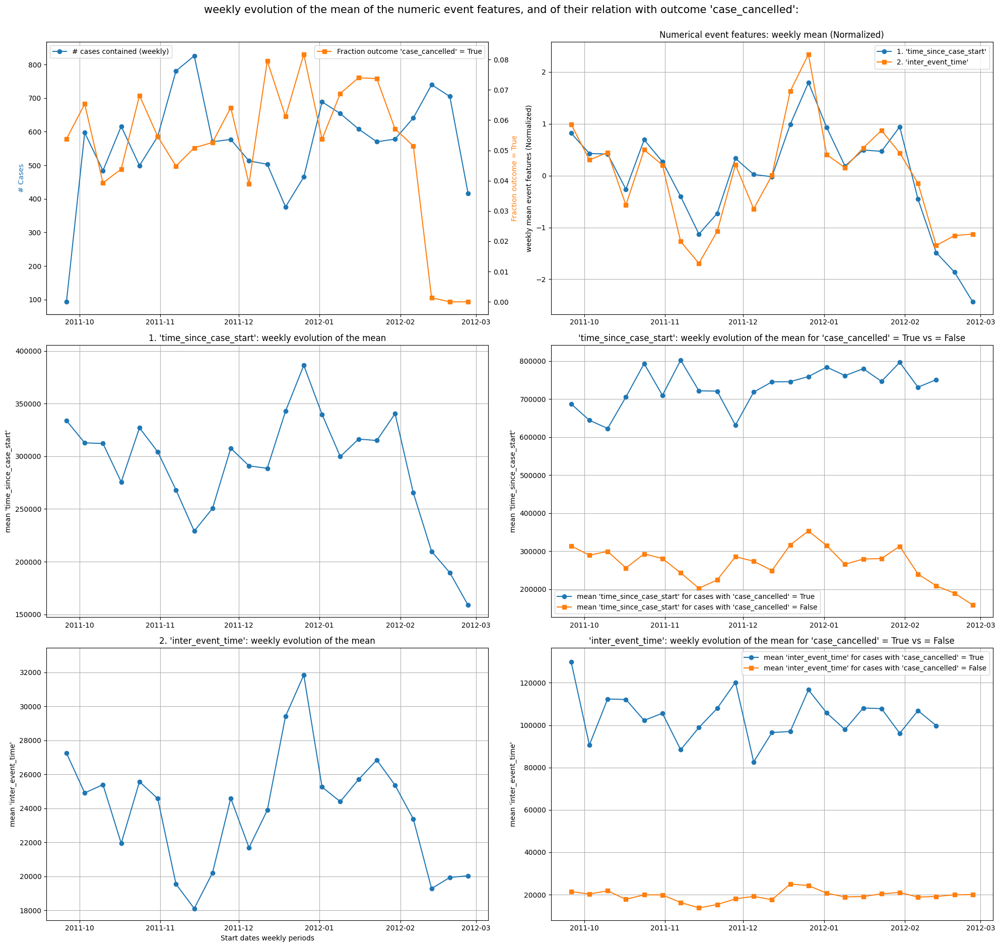

In [42]:
bpic12_plots.set_outcomeColumn(outcome = 'case_cancelled')
bpic12_plots.num_eventfts_evol(numeric_event_list = numeric_eventfeatures, plt_type = 'type_outcome', numEventFt_transform = 'mean')